In [101]:
import numpy as np
from PIL import Image

%matplotlib inline

In [102]:
img = Image.open('bangalore.png').convert('RGB')

In [103]:
img = img.crop(box=(0,0,2048,2048))

In [104]:
img.size

(2048, 2048)

In [138]:
from collections import defaultdict

def split(img, ntiles):
    np_img = np.array(img)
    h,w,c = np_img.shape
    s = h // ntiles
    d = defaultdict(dict)
    
    for i in range(ntiles):
        for j in range(ntiles):
            d[str(i)+str(j)]['img'] = Image.fromarray(np_img[s*i:s*(i+1), s*j:s*(j+1),:])
    
    return d

def merge(d, ntiles):
    s = d['00']['img'].size[0]

    img = Image.new('RGBA', (s*ntiles,s*ntiles))
    
    for i in range(ntiles):
        for j in range(ntiles):
            base = d[str(i)+str(j)]['img'].convert('RGBA')
            rect = Image.new('RGBA', base.size, (255,255,255,0))
            r = ImageDraw.Draw(rect)
            r.rectangle([(0,0), base.size], fill=(255,0,0,randint(0,100)))
            out = Image.alpha_composite(base, rect)
            
            img.paste(out, box=(s*j, s*i))
            
    return img

In [139]:
imgs = split(img, 4)

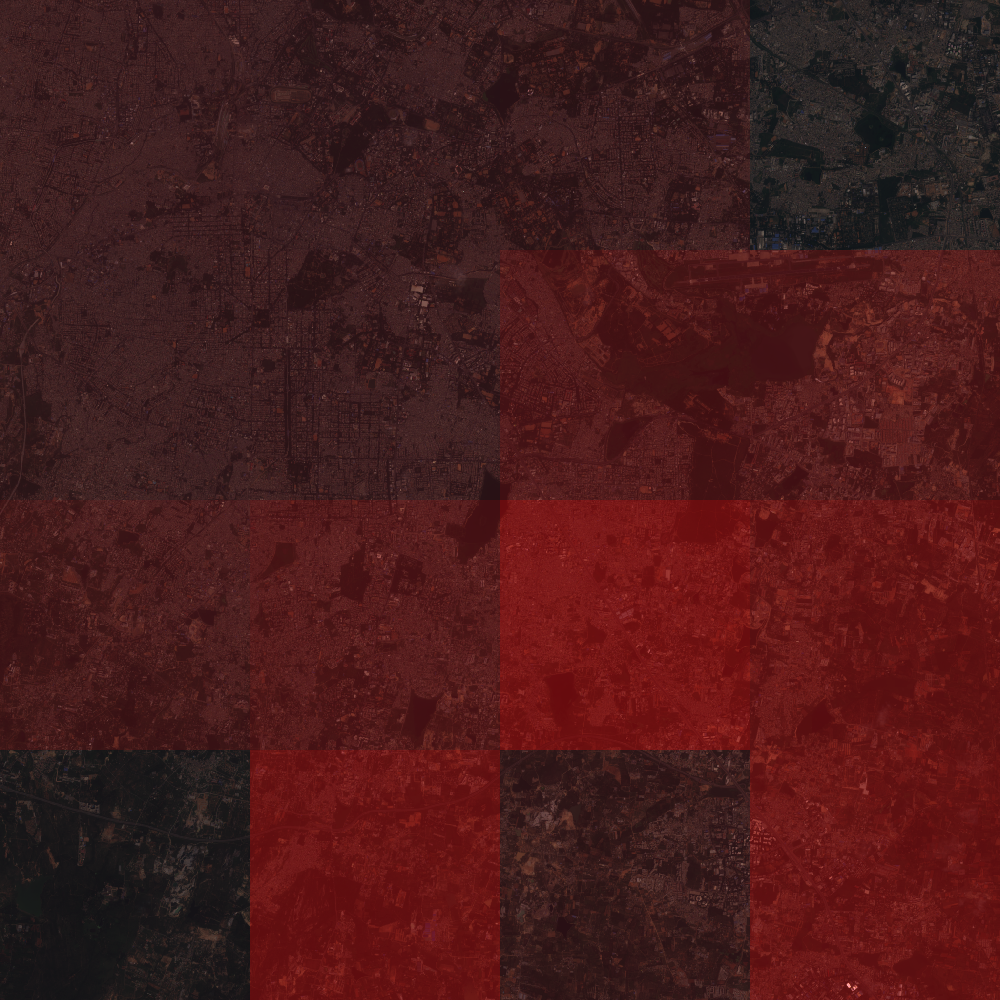

In [140]:
merge(imgs, 4)

In [108]:
from PIL import ImageDraw
from random import randint

In [109]:
randint(0, 100)

92

In [112]:
base = imgs['00'].convert('RGBA')
rect = Image.new('RGBA', base.size, (255,255,255,0))
d = ImageDraw.Draw(rect)
d.rectangle([(0,0), base.size], fill=(255,0,0,100))
out = Image.alpha_composite(base, rect)

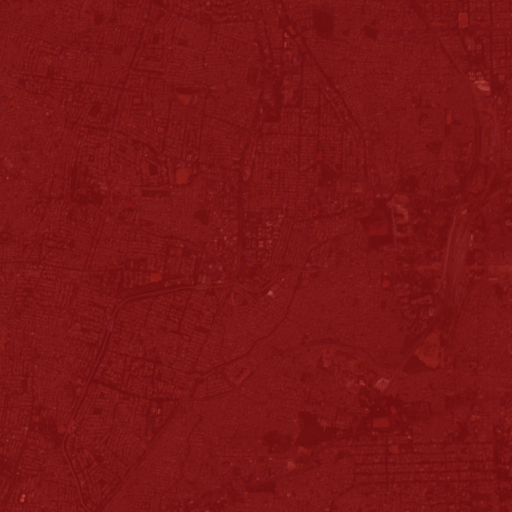

In [113]:
out

In [124]:
new_img = merge(imgs, 4)

TypeError: 'ImageDraw' object is not subscriptable

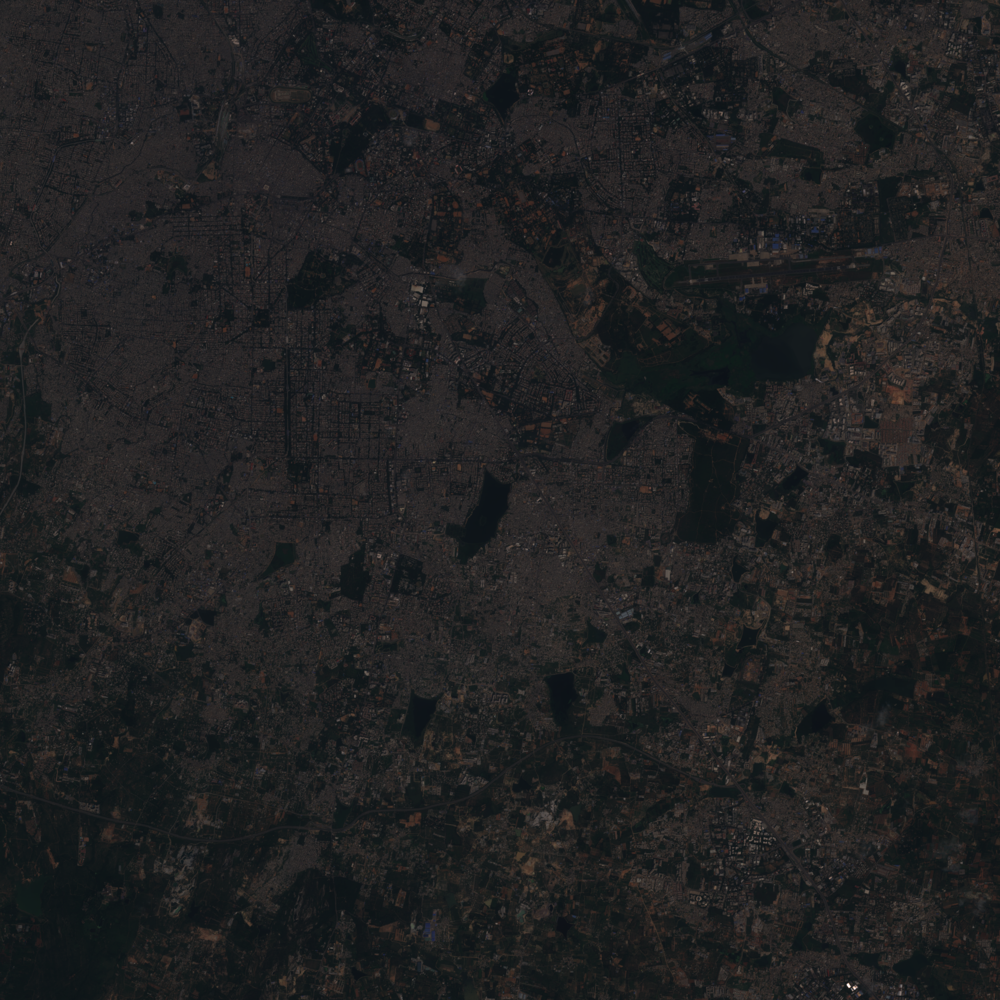

In [120]:
new_img

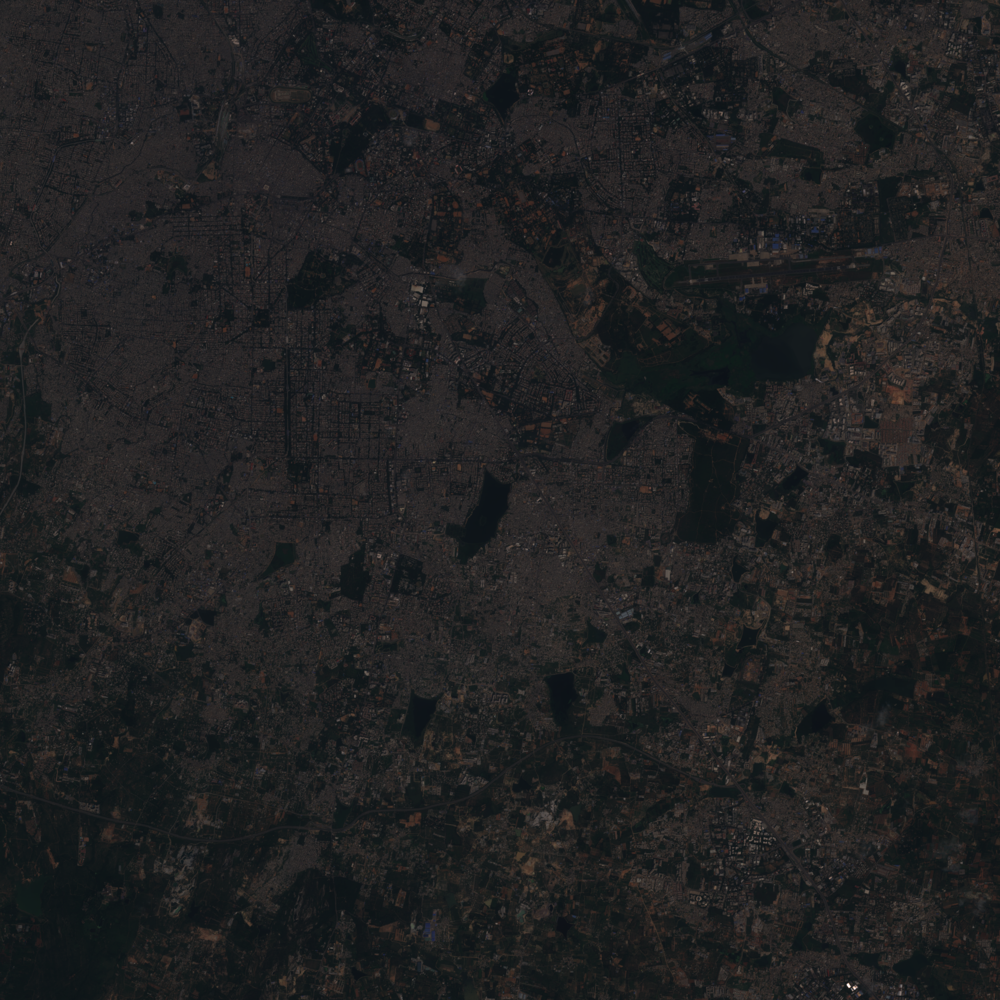

In [35]:
img